In [1]:
import sys
import os
sys.path.append(os.path.abspath(os.path.join(os.path.abspath('.'), '../vision_tokenizer/')))

import argparse
import traceback
import logging
from functools import partial
import numpy as np

from PIL import Image
import re  # Added for parsing image tokens
from typing import List, Tuple
import matplotlib.pyplot as plt

# --- Add necessary imports from your ILLUME codebase ---
import torch

from transformers import LogitsProcessorList, TextIteratorStreamer

from generation_eval.models.builder import build_eval_model

from illume.constants import IMAGE_TOKEN_INDEX, DEFAULT_IMAGE_TOKEN
from illume.conversation import conv_templates, default_conversation  # Import Conversation class
from illume.mm_utils import process_images, tokenizer_image_token
from illume.data.data_utils import unpad_and_resize_back

# Logging setup
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')

model_name = 'ILLUME'

mllm_config_path="../configs/example/illume_plus_3b/illume_plus_qwen2_5_3b_stage3.py"
tokenizer_config_path="../configs/example/dualvitok/dualvitok_anyres_max512.py"
vq_tokenizer_ckpt_path="../checkpoints/dualvitok/pytorch_model.bin"
diffusion_decoder_path="../checkpoints/dualvitok-sdxl-decoder/"
torch_dtype = 'fp16'
device = 'cuda' if torch.cuda.is_available() else 'cpu'
local_rank = 0 if 'cuda' in device else -1

eval_model_cfg = dict(
    type=model_name,
    config=mllm_config_path,
    tokenizer_config=tokenizer_config_path,
    diffusion_decoder_path=diffusion_decoder_path,
    tokenizer_checkpoint=vq_tokenizer_ckpt_path,
    torch_dtype=torch_dtype
)
logging.info(f'Building ILLUME model with config: {eval_model_cfg}')
inference_engine = build_eval_model(eval_model_cfg)

# Device assignment
num_gpus = torch.cuda.device_count()
if num_gpus >= 3:
    mllm_device = torch.device('cuda:0'); vq_device = torch.device('cuda:1'); diffusion_device = torch.device('cuda:2')
elif num_gpus == 2:
    mllm_device = torch.device('cuda:0'); vq_device = torch.device('cuda:1'); diffusion_device = torch.device('cuda:1')
elif num_gpus == 1:
    mllm_device = torch.device('cuda:0'); vq_device = torch.device('cuda:0'); diffusion_device = torch.device('cuda:0')
else:
    mllm_device = torch.device('cpu'); vq_device = torch.device('cpu'); diffusion_device = torch.device('cpu')
logging.info(f'MLLM: {mllm_device}, VQ: {vq_device}, Diffusion: {diffusion_device}')

if hasattr(inference_engine, 'mllm_model') and inference_engine.mllm_model: inference_engine.mllm_model.to(mllm_device)
if hasattr(inference_engine, 'vq_model') and inference_engine.vq_model: inference_engine.vq_model.to(vq_device)
if hasattr(inference_engine, 'diffusion_decoder_pipe') and inference_engine.diffusion_decoder_pipe: inference_engine.diffusion_decoder_pipe.to(diffusion_device)

inference_engine.device = device # Overall device
inference_engine.mllm_device = mllm_device
inference_engine.vq_device = vq_device
inference_engine.diffusion_device = diffusion_device

/export/scratch/ra48gaq/conda/envs/illume/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2025-07-29 15:10:02 - root - INFO - Building ILLUME model with config: {'type': 'ILLUME', 'config': '../configs/example/illume_plus_3b/illume_plus_qwen2_5_3b_stage3.py', 'tokenizer_config': '../configs/example/dualvitok/dualvitok_anyres_max512.py', 'diffusion_decoder_path': '../checkpoints/dualvitok-sdxl-decoder/', 'tokenizer_checkpoint': '../checkpoints/dualvitok/pytorch_model.bin', 'torch_dtype': 'fp16'}


build mllm
model_path, ./logdir/illume_plus_3b/illume_plus-qwen2_5-3b_stage3/
model_base, None
model_name, illume_plus-qwen2_5-3b_stage3
vq_config /export/home/ra48gaq/code/ILLUME_plus/configs/example/dualvitok/dualvitok_anyres_max512.py


/export/scratch/ra48gaq/conda/envs/illume/lib/python3.9/site-packages/torch/nn/modules/module.py:2397: UserWarning: for patch_embed.proj.weight: copying from a non-meta parameter in the checkpoint to a meta parameter in the current model, which is a no-op. (Did you mean to pass `assign=True` to assign items in the state dictionary to their corresponding key in the module instead of copying them in place?)
  warnings.warn(
/export/scratch/ra48gaq/conda/envs/illume/lib/python3.9/site-packages/torch/nn/modules/module.py:2397: UserWarning: for blocks.0.norm1.weight: copying from a non-meta parameter in the checkpoint to a meta parameter in the current model, which is a no-op. (Did you mean to pass `assign=True` to assign items in the state dictionary to their corresponding key in the module instead of copying them in place?)
  warnings.warn(
/export/scratch/ra48gaq/conda/envs/illume/lib/python3.9/site-packages/torch/nn/modules/module.py:2397: UserWarning: for blocks.0.norm1.bias: copying f

Current model is: DualViTok, initialization finished.


Loading checkpoint shards: 100%|██████████| 2/2 [00:26<00:00, 13.37s/it]


tokenizer_length: 282776
mllm model dtype: torch.bfloat16
model device: cuda:0
build mllm done
build detokenizer
Current model is: DualViTok, initialization finished.
<All keys matched successfully>
use diffusion decoder


Loading pipeline components...: 100%|██████████| 3/3 [00:01<00:00,  1.58it/s]
2025-07-29 15:13:46 - root - INFO - MLLM: cuda:0, VQ: cuda:0, Diffusion: cuda:0


build detokenizer done


In [2]:
import math
import random
from collections import defaultdict
from ILLUME.imagenet_hierarchy import direct_subclasses
from ILLUME.compute_class_predictions import build_context_set
from tqdm.auto import trange
from einops import rearrange
from torchvision.transforms import functional as F

def generate_images_illume(cls, imgs_per_attr, hierarchy_name, set_direction_attr, bs, ctx_images, q_images, model, n_ctx, base_seed, device, use_21k_ctx, use_21k_q, prompt_scheme, img_res: int =256):

    generated_images_per_q_cls = defaultdict(list)
    direct_subclasses_qt = direct_subclasses[hierarchy_name][set_direction_attr]
    num_iters = math.ceil(imgs_per_attr // bs)
    queries_per_iter = bs
    print(f"num_iters is {num_iters} ; queries_per_iter is {queries_per_iter} ; bs is {bs}", flush=True)

    prompt_und = prompt_scheme['understanding']

    inference_config_understanding = model.prepare_inference_config(
                                temperature=1.0,
                                top_k=50,
                                top_p=1.0,
                            )
    
    unconditional_prompt = inference_engine.default_editing_unconditional_template.format(resolution_tag='')
    inference_config_gen = inference_engine.prepare_inference_config(
        temperature=1.0,
        top_k=128,
        top_p=1.0,
        
        llm_cfg_scale = 1.5,
        diffusion_cfg_scale=1.5,
        diffusion_num_inference_steps=50,
        
        image_semantic_temperature= 0.7,
        image_semantic_top_k = 512,
        image_semantic_top_p = 0.8,
        unconditional_prompt=unconditional_prompt,
        resolution=(img_res,img_res)  # the resolution will be obtrain from the source image within the code.
    )

    for iter in trange(num_iters):
        context_set = build_context_set(rel_attr=set_direction_attr, images=ctx_images, 
                                        hierarchy_name=hierarchy_name, n_ctx=4, use_21k_ctx=use_21k_ctx).to(device=device, dtype=torch.bfloat16) # 1 c n_ctx h w"
        
        # Tile the context set
        context_set = rearrange(context_set, "1 c (row col) h w -> c (row h) (col w)", row=2, col=2).float() # range[-1, 1]
        # print(f"{context_set.shape=} ; {context_set.min()=} ; {context_set.max()=}", flush=True)
        # convert to PIL images
        context_set = F.to_pil_image((context_set + 1) / 2)
        context_set.show()

        qt_leaf_classes = [cls] * queries_per_iter
        random.seed(base_seed + iter)
        query_list = [random.choice(q_images[leaf_cls]) for leaf_cls in qt_leaf_classes] # list of (c, h, w) tensors
        # print(f"{query_list[0].max()=} ; {query_list[0].min()=}", flush=True)

        query_tensor_tiled = (torch.stack(query_list, dim=0).float() + 1) / 2  # b c h w
        # print(f"{query_tensor_tiled.shape=} ; {query_tensor_tiled.min()=} ; {query_tensor_tiled.max()=}", flush=True)
        query_img_tiled = F.to_pil_image(rearrange(query_tensor_tiled, "b c h w -> c h (b w)"))
        query_img_tiled.show()
        query_list_pil = [F.to_pil_image((q.float() + 1) / 2) for q in query_list]  # convert to PIL images
        # query = torch.cat([rearrange(q, " c h w -> 1 c 1 h w") for q in query_list], dim=0).to(device=device, dtype=torch.bfloat16)
        # query_list_pil[0].show()
        # query_list_pil[1].show()
        # print(f"{len(query_list_pil)} ; {query_list_pil[0].size=}", flush=True)

        n_qs = len(query_list)

        # context_set_broadcast = repeat(context_set, "1 c n_ctx h w -> n_qs c n_ctx h w", n_qs=n_qs).to(device=device, dtype=torch.bfloat16)

        with torch.no_grad():
            batch_data = [
                dict(prompt=prompt_und, images_data=[context_set])
            ] * bs
            # Infer common feature of context set
            outputs = model.inference_mllm(
                            batch_data, inference_config_understanding,
                            is_img_gen_task=False,  #  Remember to set this for image understanding. 
                            do_sample=False  # You could add more params for the model.generate.
                        )
            
            common_features = [outputs[i]['output_text'] for i in range(len(outputs))]
            print(f"common features: {common_features}", flush=True)
            instructions = [prompt_scheme['generation'].replace("<answer_1>", comm_feat) for comm_feat in common_features]
            # instructions = [f'Take the common feature from the query image and generate a new image with it. The feature you inferred as common is: {comm_feat}.' for comm_feat in common_features]
            print(f"{instructions=}", flush=True)

            prompts = [inference_engine.default_editing_template.format(resolution_tag='', content=instruction) for instruction in instructions]
            batch_data = [dict(prompt=prompts[i], images_data=[query_list_pil[i]]) for i in range(bs)]
            # Generate image tokens
            outputs = inference_engine.inference_mllm(batch_data, inference_config_gen, is_img_gen_task=True)

            # print(f"{outputs=}", flush=True)
            # print(f"{len(outputs[0]['image_embed_inds'])=}", flush=True)
            # # Decode image tokens Using sdxl diffusion decoder
            # out_images = inference_engine.inference_tokenizer_decoder(outputs, inference_config_gen, use_diffusion_decoder=True)

            # print(f"{outputs[0]['image_sizes']=}", flush=True)
            print(f"Starting to decode generated tokens ...")

            #  using vq tokenizer to decode image.
            out_images = inference_engine.inference_tokenizer_decoder(outputs, inference_config_gen, use_diffusion_decoder=False)

        out_tensor = torch.stack([torch.from_numpy(out_img) for out_img in out_images], dim=0)
        print(f"{out_tensor.shape=} ; {out_tensor.min()=} ; {out_tensor.max()=} ; {out_tensor.dtype=}", flush=True)
        out_tensor = rearrange(out_tensor, "n_q h w c -> c h (n_q w)")  # Rearrange to (n_q, h, w, c)
        F.to_pil_image(out_tensor).show()

        for n_q in range(queries_per_iter):
            sample_n_q = out_images[n_q]
            # print(f"{sample_n_q.shape=} ; {sample_n_q.min()=} ; {sample_n_q.max()=} ; {sample_n_q.dtype=}", flush=True)
            # F.to_pil_image(rearrange(sample_n_q, "h w c -> c h w")).show()
            # F.to_pil_image(sample_n_q).show()

            sample_n_q_tensor = torch.from_numpy(sample_n_q).float() / 255.0  # Convert to tensor and normalize to range [0, 1]
            print(f"{sample_n_q_tensor.shape=} ; {sample_n_q_tensor.min()=} ; {sample_n_q_tensor.max()=} ; {sample_n_q_tensor.dtype=}", flush=True)
            
            generated_images_per_q_cls[qt_leaf_classes[n_q]].append(sample_n_q_tensor)

    return generated_images_per_q_cls

In [4]:
import glob
import webdataset as wds
import torchvision.transforms as T
from collections import defaultdict
from torch.utils.data import DataLoader
from ILLUME.imagenet_hierarchy import hierarchy_attr_to_classes, direct_subclasses, id_to_syn_name, super_class_dir, n_str_mapping
from tqdm.auto import tqdm

data_path = "/export/group/datasets/imagenet_shards_raw_shuffled/"

print("Loading ImgNet into memory ...")
# imgnet_path = os.path.join(data_path, "imagenet_val_{000000..000006}.tar")
imgnet_path = sorted(glob.glob(os.path.join(data_path, "imagenet_val_*.tar")))
print(f"imgnet_path is {imgnet_path}")
# Load ImageNet val split into memory
# ds = wds.WebDataset(imgnet_path, 
#                     nodesplitter=None).decode('torch').map_dict(jpg = T.Compose([
#         T.Resize(256),
#         T.CenterCrop(256),
#         T.Lambda(lambda x: x * 2 - 1),
#         T.Lambda(lambda x: x.bfloat16()),
#     ]
#     ),).batched(32)
ds = wds.WebDataset(imgnet_path, 
                    nodesplitter=None).decode('torch').map_dict(jpg = T.Compose([
        T.Resize(256),
        T.CenterCrop(256),
        T.Lambda(lambda x: x * 2 - 1),
        T.Lambda(lambda x: x.bfloat16()),
    ]
    ),)

imgnet_dl = DataLoader(ds, num_workers=7, batch_size=32)

# Fill up dictionary with images per class
imgnet_images = defaultdict(list)
for b in tqdm(imgnet_dl):
    # print(f"iter, len(b['cls_name'] = {b['cls_name']})")
    for cls_name, t in zip(b["cls_name"], b["jpg"]):
        imgnet_images[n_str_mapping[cls_name.decode("utf-8")]].append(t)

/export/scratch/ra48gaq/conda/envs/illume/lib/python3.9/site-packages/webdataset/compat.py:136: UserWarning: WebDataset(shardshuffle=...) is None; set explicitly to False or a number
  warnings.warn("WebDataset(shardshuffle=...) is None; set explicitly to False or a number")


Loading ImgNet into memory ...
imgnet_path is ['/export/group/datasets/imagenet_shards_raw_shuffled/imagenet_val_000000.tar', '/export/group/datasets/imagenet_shards_raw_shuffled/imagenet_val_000001.tar', '/export/group/datasets/imagenet_shards_raw_shuffled/imagenet_val_000002.tar', '/export/group/datasets/imagenet_shards_raw_shuffled/imagenet_val_000003.tar', '/export/group/datasets/imagenet_shards_raw_shuffled/imagenet_val_000004.tar', '/export/group/datasets/imagenet_shards_raw_shuffled/imagenet_val_000005.tar', '/export/group/datasets/imagenet_shards_raw_shuffled/imagenet_val_000006.tar']


0it [00:00, ?it/s]huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingfac

num_iters is 12 ; queries_per_iter is 8 ; bs is 8


  0%|          | 0/12 [00:00<?, ?it/s]

set_clss: ['lynx.n.02', 'coho.n.02', 'chimpanzee.n.01', 'frilled_lizard.n.01'] ; use_21k_ctx: False


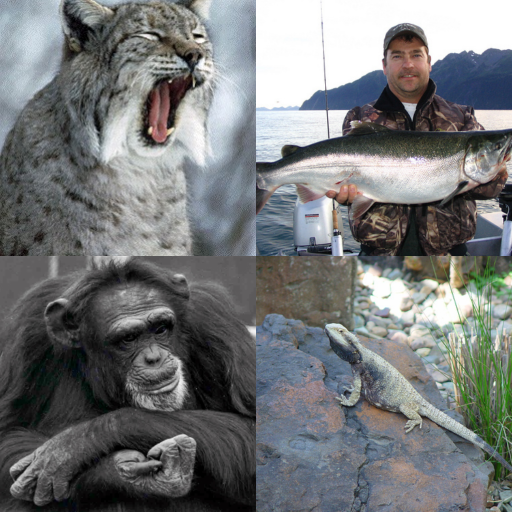

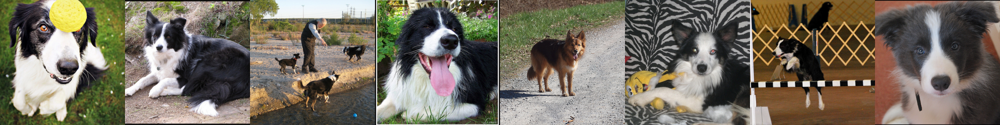

len(input_ids_list[0])=40
common features: ['All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.']
instructions=['This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contai

We detected that you are passing `past_key_values` as a tuple and this is deprecated and will be removed in v4.43. Please use an appropriate `Cache` class (https://huggingface.co/docs/transformers/v4.41.3/en/internal/generation_utils#transformers.Cache)


Starting to decode generated tokens ...
out_tensor.shape=torch.Size([8, 256, 256, 3]) ; out_tensor.min()=tensor(0, dtype=torch.uint8) ; out_tensor.max()=tensor(255, dtype=torch.uint8) ; out_tensor.dtype=torch.uint8


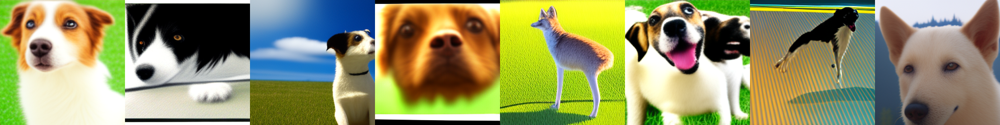

sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tenso

  8%|▊         | 1/12 [00:33<06:03, 33.02s/it]

set_clss: ['anemone_fish.n.01', 'bedlington_terrier.n.01', 'garden_spider.n.01', 'african_grey.n.01'] ; use_21k_ctx: False


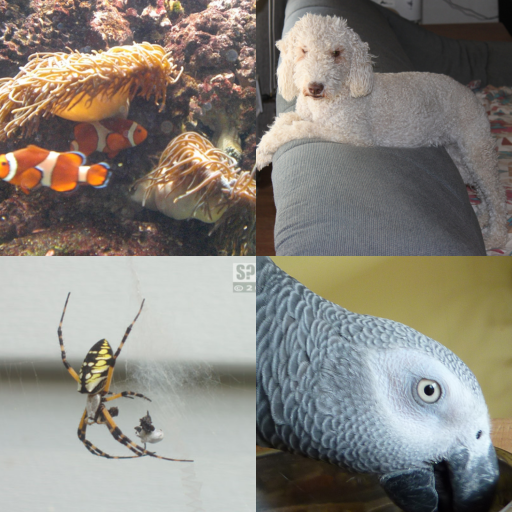

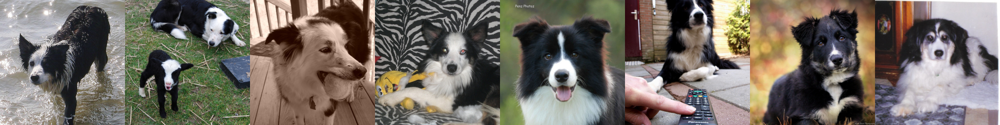

len(input_ids_list[0])=40
common features: ['All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.']
instructions=['This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contai

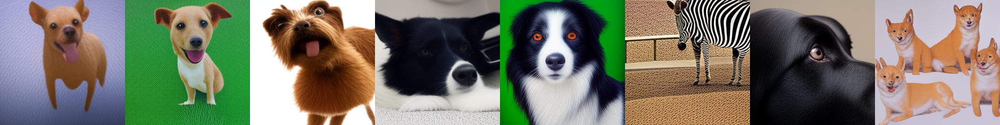

sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.0314) ; sample_n_q_tensor.max()=tensor(0.9059) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(0.9098) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(0.9922) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32


 17%|█▋        | 2/12 [01:02<05:11, 31.20s/it]

set_clss: ['anemone_fish.n.01', 'bedlington_terrier.n.01', 'garden_spider.n.01', 'african_grey.n.01'] ; use_21k_ctx: False


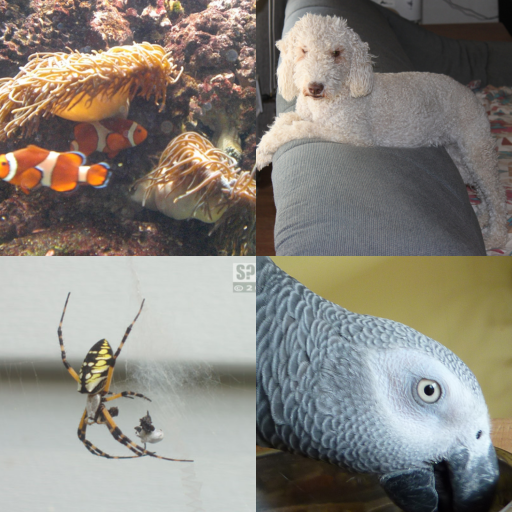

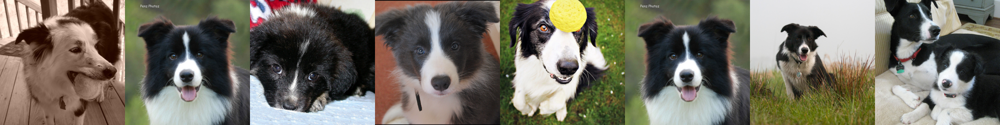

len(input_ids_list[0])=40
common features: ['All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.']
instructions=['This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contai

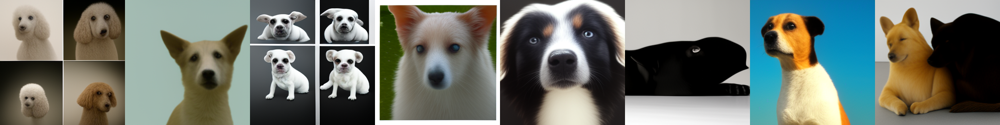

sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(0.7490) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.0118) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n

 25%|██▌       | 3/12 [01:32<04:34, 30.55s/it]

set_clss: ['anemone_fish.n.01', 'bedlington_terrier.n.01', 'garden_spider.n.01', 'african_grey.n.01'] ; use_21k_ctx: False


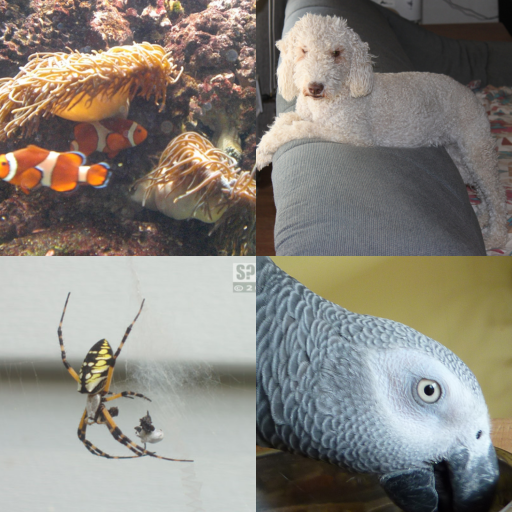

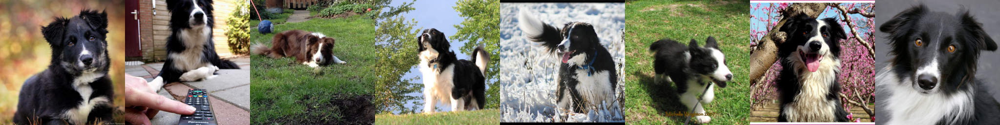

len(input_ids_list[0])=40
common features: ['All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.']
instructions=['This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contai

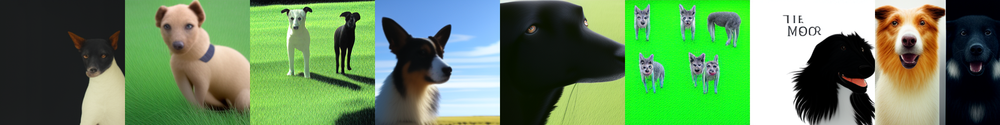

sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.0196) ; sample_n_q_tensor.max()=tensor(0.8863) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(0.9961) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.0235) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32


 33%|███▎      | 4/12 [02:02<04:00, 30.12s/it]

set_clss: ['anemone_fish.n.01', 'bedlington_terrier.n.01', 'garden_spider.n.01', 'african_grey.n.01'] ; use_21k_ctx: False


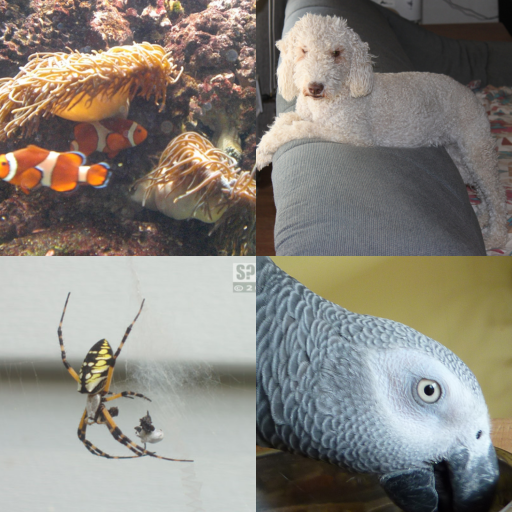

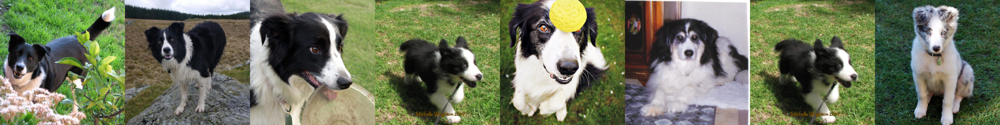

len(input_ids_list[0])=40
common features: ['All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.']
instructions=['This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contai

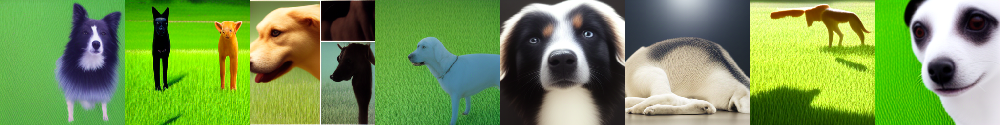

sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.0431) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.0314) ; sample_n_q_tensor.max()=tensor(0.8353) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.0118) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.0235) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.floa

 42%|████▏     | 5/12 [02:31<03:29, 29.91s/it]

set_clss: ['anemone_fish.n.01', 'bedlington_terrier.n.01', 'garden_spider.n.01', 'african_grey.n.01'] ; use_21k_ctx: False


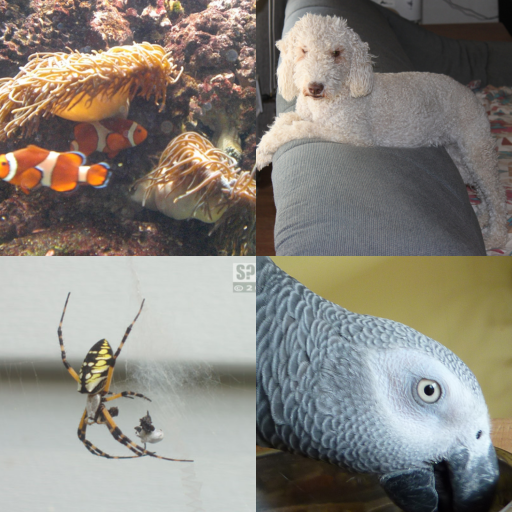

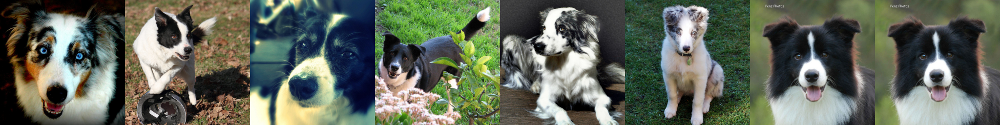

len(input_ids_list[0])=40
common features: ['All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.']
instructions=['This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contai

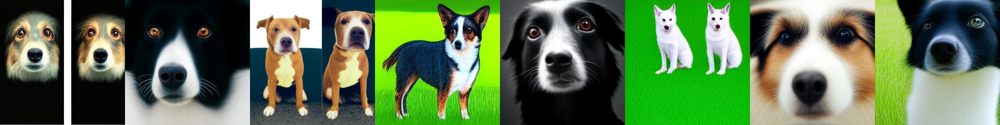

sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(0.9922) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_t

 50%|█████     | 6/12 [03:01<02:59, 29.94s/it]

set_clss: ['anemone_fish.n.01', 'bedlington_terrier.n.01', 'garden_spider.n.01', 'african_grey.n.01'] ; use_21k_ctx: False


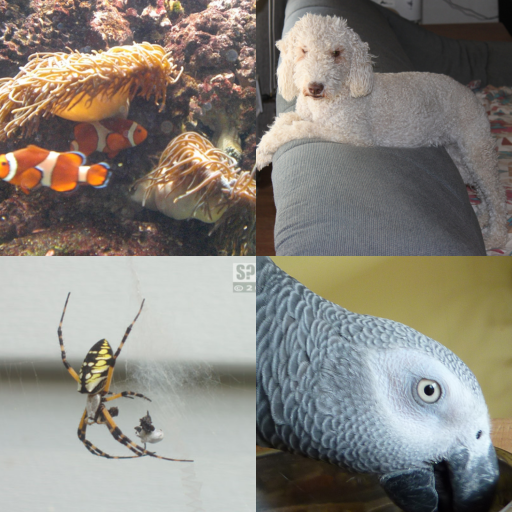

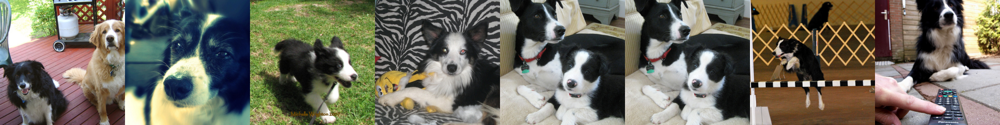

len(input_ids_list[0])=40
common features: ['All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.']
instructions=['This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contai

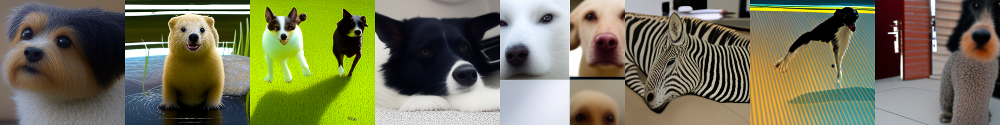

sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.0039) ; sample_n_q_tensor.max()=tensor(0.7882) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n

 58%|█████▊    | 7/12 [03:31<02:29, 29.86s/it]

set_clss: ['anemone_fish.n.01', 'bedlington_terrier.n.01', 'garden_spider.n.01', 'african_grey.n.01'] ; use_21k_ctx: False


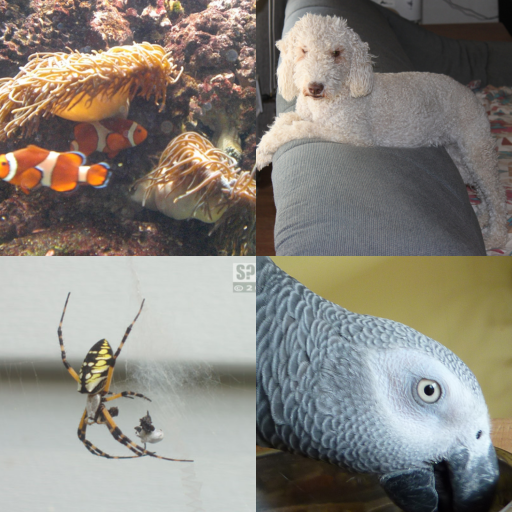

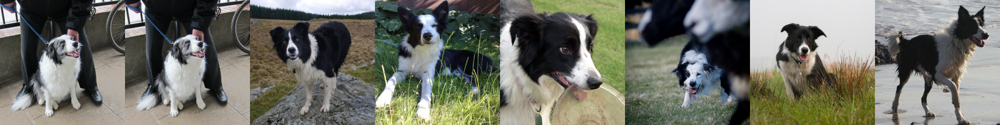

len(input_ids_list[0])=40
common features: ['All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.']
instructions=['This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contai

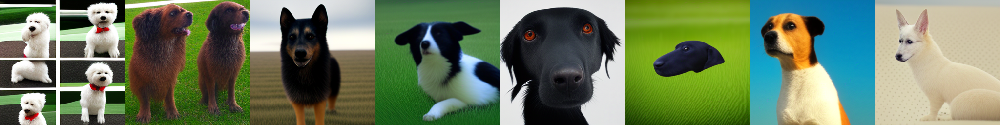

sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(0.7608) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_t

 67%|██████▋   | 8/12 [04:01<01:59, 29.84s/it]

set_clss: ['anemone_fish.n.01', 'bedlington_terrier.n.01', 'garden_spider.n.01', 'african_grey.n.01'] ; use_21k_ctx: False


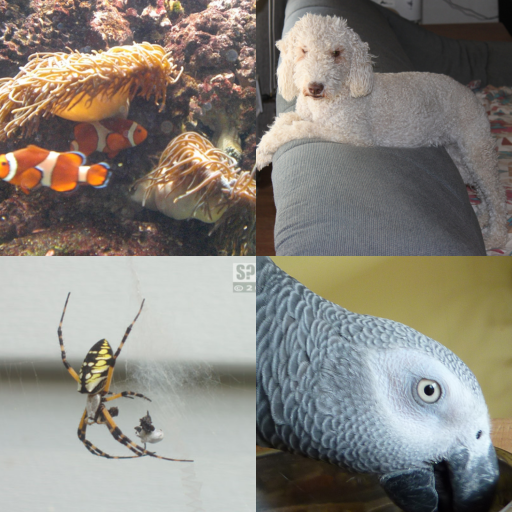

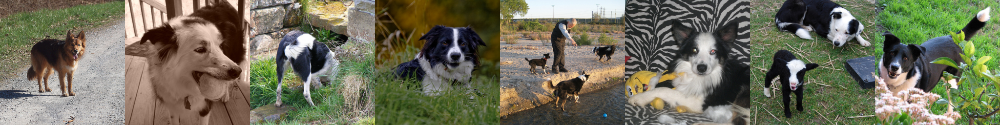

len(input_ids_list[0])=40
common features: ['All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.']
instructions=['This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contai

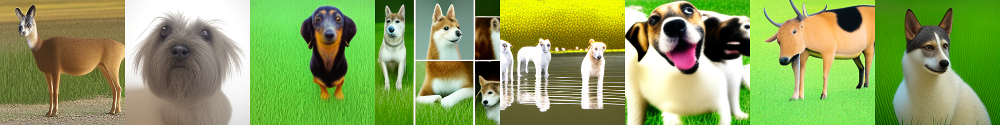

sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.0039) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.0706) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(0.9608) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
sample_n_q_tensor.shape=torch.Size([256, 256, 3]) ; sample_n_q_tensor.min()=tensor(0.) ; sample_n_q_tensor.max()=tensor(1.) ; sample_n_q_tensor.dtype=torch.float32
samp

 75%|███████▌  | 9/12 [04:31<01:29, 29.85s/it]

set_clss: ['anemone_fish.n.01', 'bedlington_terrier.n.01', 'garden_spider.n.01', 'african_grey.n.01'] ; use_21k_ctx: False


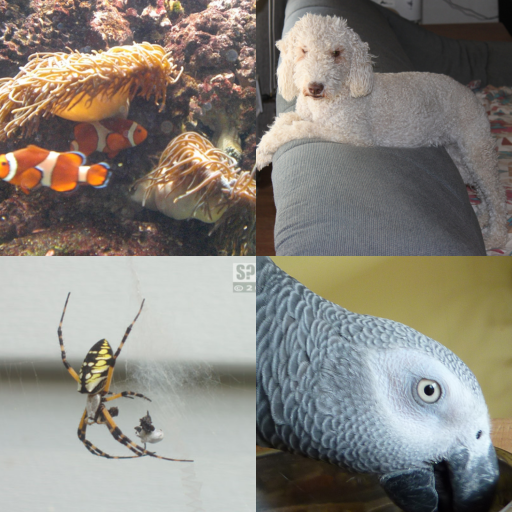

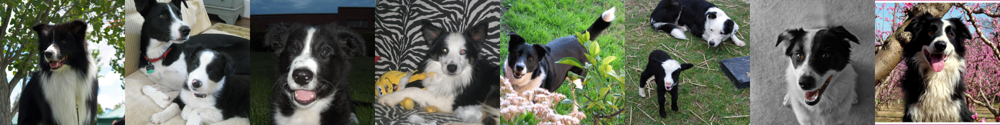

len(input_ids_list[0])=40
common features: ['All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.', 'All four images feature animals.']
instructions=['This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contains an instance of the aforementioned common feature: All four images feature animals. Please generate a new image that only includes this common feature, no other aspect from the given image.', 'This image contai

In [ ]:
animal_cls = "border_collie.n.01"
model=inference_engine
hierarchy_name = 'extended_v1'
imgs_per_attr = 100

set_direction_attr = "animal.n.01"
n_ctx = 4
base_seed=1234
use_21k_ctx = False
use_21k_q = False
bs=8

prompt_schemes = [{'understanding': 'What is a common feature between these four images? Answer concisely in a few words.',
                   'generation': 'Take the common feature from the query image and generate a new image with it. The feature you inferred as common is: <answer_1>'},
                  {'understanding': 'What is a common feature between these four images? Answer concisely in a few words.',
                   'generation': 'This image contains an instance of a relevant feature that you previously described as: <answer_1> Please generate a new image that only includes the relevant feature, no other aspect from the given image.'},
                  {'understanding': 'What is feature that is shared among these images? Answer concisely in a few words.',
                   'generation': 'Please reproduce the relevant feature from the query image, all other features can be removed/changed. The relevant feature is <answer_1>'}]

prompt_scheme = prompt_schemes[1]


ctx_images = imgnet_images
q_images = imgnet_images

generated_images_per_q_cls = generate_images_illume(cls=animal_cls, imgs_per_attr=imgs_per_attr, hierarchy_name=hierarchy_name, 
                            set_direction_attr=set_direction_attr, bs=bs, ctx_images=ctx_images, q_images=q_images, model=model, n_ctx=n_ctx, base_seed=base_seed, 
                            device=device, use_21k_ctx=use_21k_ctx, use_21k_q=use_21k_q, prompt_scheme=prompt_scheme)

In [12]:
model.torch_dtype

torch.float16